<a href="https://colab.research.google.com/github/rqqqqqqq/FYP-Project/blob/main/CM3070_FYP_Part1_190488303.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# CM3070 Final Year Project: Bitcoin Price Forecasting - PART 1

Template 1: Deep Learning on a Public Dataset (Machine Learning)		
Done by Student Number: 190488303

## Project Deliverables

1. Introduction 
  
        1.1 Aims and objectives

2. Import data, libraries and packages
3. Exploratory data analysis - EDA
4. Data preparation

        4.1 Data cleaning
        4.2 Data splitting
        4.3 Pre-processing

5. Modelling
    
      5.1 Baseline (Support vector regression (SVR))
          5.1.1 Modelling
          5.1.2 Prediction
          5.1.3 MAE, MSE, RMSE 
          5.1.4 Explained variance regression score, R2 score  

      5.2 XGBoost 
          5.2.1 Modelling
          5.2.2 Prediction
          5.2.3 MAE, MSE, RMSE 
          5.2.4 Explained variance regression score, R2 score  

      5.3 Long Short Term Memory (LSTM)
          5.3.1 Modelling
          5.3.2 Prediction
          5.3.3 MAE, MSE, RMSE 
          5.3.4 Explained variance regression score, R2 score  

      5.4 Linear regression
          5.4.1 Modelling
          5.4.2 Prediction
          5.4.3 MAE, MSE, RMSE 
          5.4.4 Explained variance regression score, R2 score  

      5.5 ARIMA model
          5.5.1 Modelling
          5.5.2 Prediction
          5.5.3 MAE, MSE, RMSE 
          5.5.4 Explained variance regression score, R2 score  

6. Conclusion

## 1. Introduction

This project conceptualizes the idea of using a machine learning model for bitcoin price forecasting. The aim is to see if it is possible to predict the future price of bitcoin, and if so, how to increase its efficiency by using different machine learning models.

The objective for this project is to increase competitiveness when buying or selling bitcoin, in order to make more money. If successful, it can be used from a personal standpoint, for casual bitcoin buyers to make more informed decisions when timing the cryptocurrency market such that they can make more profitable purchases. It can also be adopted from a commercial standpoint, where brokerage firms or financial advisors can implement the methodology to make more informed financial decisions for their clients when buying bitcoin, thus increasing their credibility and success as a service. 


The aim of this project is to explore the potential use of different models for the purpose of bitcoin price predication, or more specifically, the LSTM model. The project would include data preparation, the creation of baseline models as performance evaluators, and the creation of LSTM forecasting model. 





## 2. Import data, libraries and packages

This project uses project template 1, which is deep learning on a public dataset, adapted from Kaggle. Kaggle is open-source and community maintained, making it ethically appropriate to be used for this project. The data shows one-minute intervals from select exchanges from January 2012 to March 2021. The timestamps are in Unix time, and it contains minute updates of OLCH prices (Open, High, Low, Close). [5]

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
ls drive/MyDrive/bitcoin_data.csv

drive/MyDrive/bitcoin_data.csv


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from datetime import datetime
import gc
import plotly.graph_objs as go

from sklearn.model_selection import TimeSeriesSplit
from sklearn.model_selection import train_test_split

from plotly import tools
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)

In [ ]:
# create funcion to render and plot graph

def plot_function():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False)

In [ ]:
#create a function for conversion for the native timestamps in the csv file

import datetime, pytz

def dateparse (time_in_secs):    
    return pytz.utc.localize(datetime.datetime.fromtimestamp(float(time_in_secs)))

bitcoin_df = pd.read_csv("drive/MyDrive/bitcoin_data.csv", parse_dates = [0], date_parser = dateparse)
bitcoin_df.head()

,Timestamp,Open,High,Low,Close,Volume_(BTC),Volume_(Currency),Weighted_Price
0,2011-12-31 07:52:00+00:00,4.39,4.39,4.39,4.39,0.455581,2.0,4.39
1,2011-12-31 07:53:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2011-12-31 07:54:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2011-12-31 07:55:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2011-12-31 07:56:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## 3. Exploratory data analysis - EDA

In [ ]:
# fill data that have no trades

bitcoin_df['Open'].fillna(method='ffill', inplace=True)
bitcoin_df['Low'].fillna(method='ffill', inplace=True)
bitcoin_df['Close'].fillna(method='ffill', inplace=True)
bitcoin_df['High'].fillna(method='ffill', inplace=True)

bitcoin_df['Weighted_Price'].fillna(method='ffill', inplace=True)
bitcoin_df['Volume_(Currency)'].fillna(method='ffill', inplace=True)
bitcoin_df['Volume_(BTC)'].fillna(method='ffill', inplace=True)

bitcoin_df = bitcoin_df.groupby([pd.Grouper(key='Timestamp', freq='H')]).first().reset_index()

print('Amount of null values:',bitcoin_df.isnull().values.sum())

bitcoin_df.head()

Amount of null values: 749


,Timestamp,Open,High,Low,Close,Volume_(BTC),Volume_(Currency),Weighted_Price
0,2011-12-31 07:00:00+00:00,4.39,4.39,4.39,4.39,0.455581,2.0,4.39
1,2011-12-31 08:00:00+00:00,4.39,4.39,4.39,4.39,0.455581,2.0,4.39
2,2011-12-31 09:00:00+00:00,4.39,4.39,4.39,4.39,0.455581,2.0,4.39
3,2011-12-31 10:00:00+00:00,4.39,4.39,4.39,4.39,0.455581,2.0,4.39
4,2011-12-31 11:00:00+00:00,4.39,4.39,4.39,4.39,0.455581,2.0,4.39


In [ ]:
# creating plots with plotly https://plot.ly/python/

plot_function()

trace1 = go.Scatter(
    x = bitcoin_df['Timestamp'],
    y = bitcoin_df['Open'].astype(float),
    mode = 'lines',
    name = 'Open'
)

trace3 = go.Scatter(
    x = bitcoin_df['Timestamp'],
    y = bitcoin_df['Weighted_Price'].astype(float),
    mode = 'lines',
    name = 'Weighted Avg'
)

trace2 = go.Scatter(
    x = bitcoin_df['Timestamp'],
    y = bitcoin_df['Close'].astype(float),
    mode = 'lines',
    name = 'Close'
)

layout = dict(
    title='Bitcoin Prices from 2012 to 2021 (With slider function) ',
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                
                # count corresponds to no of months
                dict(count=1,
                     label='1m',
                     step='month',
                     stepmode='backward'),

                dict(count=3,
                     label='3m',
                     step='month',
                     stepmode='backward'),

                dict(count=12,
                     label='1y',
                     step='month',
                     stepmode='backward'),

                dict(count=72,
                     label='6y',
                     step='month',
                     stepmode='backward'),

                dict(step='all')
            ])
        ),
        rangeslider=dict(
            visible = True
        ),
        type='date'
    )
)
data = [trace1, trace2, trace3]
fig = dict(data = data, layout = layout)

iplot(fig, filename = "Time Series with Rangeslider")    

## 4. Data Preparation

4.1 Data cleaning


In [ ]:
# using hourly data
bitcoin_df = bitcoin_df.groupby([pd.Grouper(key='Timestamp', freq='H')]).first().reset_index()

# setting timestamp as index
bitcoin_df['Timestamp'] = bitcoin_df['Timestamp'].dt.tz_localize(None)
bitcoin_df = bitcoin_df.set_index('Timestamp')

# using weighted price to represent btc price
bitcoin_df = bitcoin_df[['Weighted_Price']]

# fill null values with previous data
bitcoin_df['Weighted_Price'].fillna(method='ffill', inplace=True)
bitcoin_df.head()

,Weighted_Price
Timestamp,
2011-12-31 07:00:00,4.39
2011-12-31 08:00:00,4.39
2011-12-31 09:00:00,4.39
2011-12-31 10:00:00,4.39
2011-12-31 11:00:00,4.39


In [ ]:
# using data from pre-covid era

day_of_split = '1-Nov-2020'
new_df = bitcoin_df.loc[bitcoin_df.index < day_of_split].copy()

print(new_df.shape)

new_df.tail()

(77465, 1)


,Weighted_Price
Timestamp,
2020-10-31 19:00:00,13721.410258
2020-10-31 20:00:00,13790.617058
2020-10-31 21:00:00,13857.773177
2020-10-31 22:00:00,13849.847259
2020-10-31 23:00:00,13876.907219


4.2 Data Splitting

In [ ]:
# splitting data into training and test sets
day_of_split = '25-Jun-2018'

testing_data = new_df.loc[new_df.index > day_of_split].copy()
training_data = new_df.loc[new_df.index <= day_of_split].copy()

print(testing_data.shape)
print(training_data.shape)

(20639, 1)
(56826, 1)


 4.3 Pre-processing

In [ ]:
# data preprocessing
set_train_val = training_data.values
set_train_val = np.reshape(set_train_val, (len(set_train_val), 1))

from sklearn.preprocessing import MinMaxScaler

mms = MinMaxScaler()
set_train_val = mms.fit_transform(set_train_val)
y_train = set_train_val[1: len(set_train_val)]
X_train = set_train_val[0: len(set_train_val)-1]

print(X_train.shape)
print(y_train.shape)

(56825, 1)
(56825, 1)


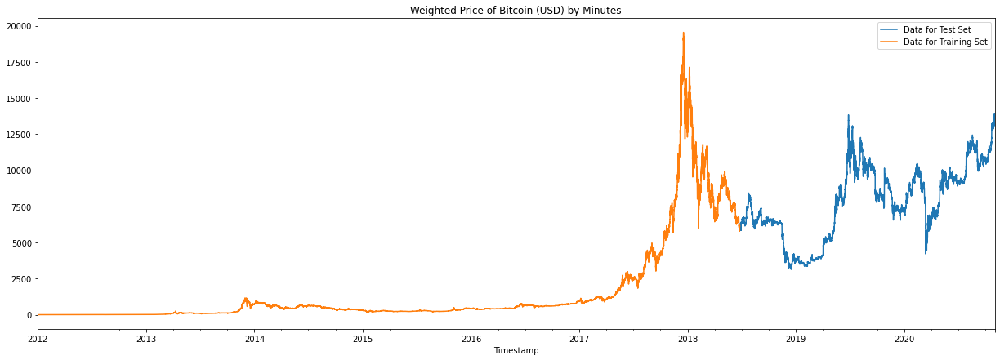

In [ ]:
# visualising training and test data
_ = testing_data \
    .rename(columns={'Weighted_Price': 'Data for Test Set'}) \
    .join(training_data.rename(columns = {'Weighted_Price': 'Data for Training Set'}), how = 'outer') \
    .plot(figsize=(21,7), title = 'Weighted Price of Bitcoin (USD) by Minutes', style='')

## 5. Modelling


### 5.1 Baseline model (Support vector regression)

5.1.1 Modelling

In [ ]:
# import Keras package and libraries

from sklearn.svm import SVR

svr_rbf_model = SVR(kernel = 'rbf', C = 1e3, gamma = 0.0001)
svr_rbf_model.fit(X_train, y_train.ravel())

SVR(C=1000.0, gamma=0.0001)

5.1.2 Prediction

In [ ]:
# forming predictions

set_test_val = testing_data.values

insert = np.reshape(set_test_val, (len(set_test_val), 1))
insert = mms.transform(insert)
insert = np.reshape(insert, (len(insert), 1))

btc_price_prediction = svr_rbf_model.predict(insert)
btc_price_prediction = btc_price_prediction.reshape(1, -1)
btc_price_prediction = mms.inverse_transform(btc_price_prediction)
btc_price_prediction = btc_price_prediction.reshape(-1, 1)

btc_price_prediction

array([[ 6924.83561092],
       [ 6907.48006686],
       [ 6893.83278297],
       ...,
       [13122.97472327],
       [13116.58476223],
       [13138.40079406]])

In [ ]:
testing_data['Weighted_Price_Prediction'] = btc_price_prediction
data_all = pd.concat([testing_data, training_data], sort=False)

# store predicted values into common dataframe 
df_last = data_all
df_last = df_last.reset_index()
df_last = df_last.rename(columns = {'Weighted_Price_Prediction': 'SVR'})
df_last = df_last[['Timestamp','Weighted_Price','SVR']]
df_last.head()

,Timestamp,Weighted_Price,SVR
0,2018-06-25 01:00:00,6169.865248,6924.835611
1,2018-06-25 02:00:00,6148.338059,6907.480067
2,2018-06-25 03:00:00,6131.410461,6893.832783
3,2018-06-25 04:00:00,6139.076296,6900.013094
4,2018-06-25 05:00:00,6141.563349,6902.018194


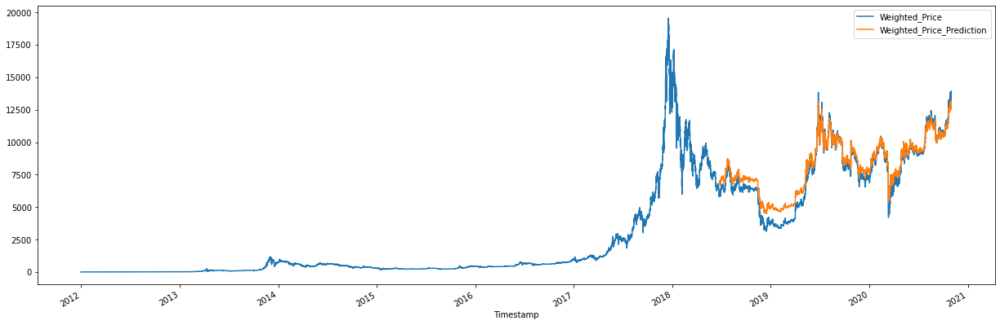

In [ ]:
_ = data_all[['Weighted_Price','Weighted_Price_Prediction']].plot(figsize = (21, 7))

5.1.3 Evaluation metrics (MAE, MSE, RMSE)

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error

mae = mean_absolute_error(y_true = testing_data['Weighted_Price'], y_pred = testing_data['Weighted_Price_Prediction'])

print("Mean Accuracy Error:\n")
print(mae)

Mean Accuracy Error:

524.2505018207187


In [ ]:
mse = mean_squared_error(y_true = testing_data['Weighted_Price'], y_pred = testing_data['Weighted_Price_Prediction'])

print("Mean Square Error:\n")
print(mse)

Mean Square Error:

425452.7992307225


In [ ]:
import math
rmse = math.sqrt(mse)

print("Root Mean Square Error:\n")
print(rmse)

Root Mean Square Error:

652.2674292272476


5.1.4 Evaluation metrics (Variance regression score, R2 score)

In [ ]:
from sklearn.metrics import explained_variance_score
evr = (explained_variance_score(y_true = testing_data['Weighted_Price'], y_pred = testing_data['Weighted_Price_Prediction']))*100

print("Explained variance regression score:", evr, "%")

Explained variance regression score: 96.2448274422399 %


In [ ]:
from sklearn.metrics import r2_score
r2 = (r2_score(y_true = testing_data['Weighted_Price'], y_pred = testing_data['Weighted_Price_Prediction']))*100

print("R2 score:", r2, "%")

R2 score: 93.09416826061518 %


### 5.2 XGBoost

5.2.1 Modelling

In [ ]:
def timeseries_feature(bitcoin_df, label=None):

    """
    Using c
    """
    bitcoin_df['Date'] = bitcoin_df.index
    bitcoin_df['Week_of_year'] = bitcoin_df['Date'].dt.weekofyear
    bitcoin_df['Day_of_week'] = bitcoin_df['Date'].dt.dayofweek
    bitcoin_df['Year'] = bitcoin_df['Date'].dt.year
    bitcoin_df['Day_of_year'] = bitcoin_df['Date'].dt.dayofyear
    bitcoin_df['Quarter'] = bitcoin_df['Date'].dt.quarter
    bitcoin_df['Hour'] = bitcoin_df['Date'].dt.hour
    bitcoin_df['Day_of_month'] = bitcoin_df['Date'].dt.day
    bitcoin_df['Month'] = bitcoin_df['Date'].dt.month
    
    X = bitcoin_df[['Hour','Day_of_week','Quarter','Month','Year',
           'Day_of_year','Day_of_month','Week_of_year']]

    if label:
        y = bitcoin_df[label]
        return X, y
    return X

In [ ]:
X_test, y_test = timeseries_feature(testing_data, label='Weighted_Price')
X_train, y_train = timeseries_feature(training_data, label='Weighted_Price')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: FutureWarning:

Series.dt.weekofyear and Series.dt.week have been deprecated.  Please use Series.dt.isocalendar().week instead.



In [ ]:
import xgboost as xgb
from xgboost import plot_importance, plot_tree

xgb_model =  xgb.XGBRegressor(objective = 'reg:linear', min_child_weight=10, booster='gbtree', colsample_bytree = 0.3, learning_rate = 0.1,
                max_depth = 5, alpha = 10, n_estimators = 100)

history = xgb_model.fit(X_train, y_train, eval_set = [(X_train, y_train), (X_test, y_test)],
        early_stopping_rounds=50, verbose = True) 

[12:13:24] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[0]	validation_0-rmse:3321.49	validation_1-rmse:8051.21
Multiple eval metrics have been passed: 'validation_1-rmse' will be used for early stopping.

Will train until validation_1-rmse hasn't improved in 50 rounds.
[1]	validation_0-rmse:3074.28	validation_1-rmse:7201.11
[2]	validation_0-rmse:3026.52	validation_1-rmse:7085.17
[3]	validation_0-rmse:2987.26	validation_1-rmse:6981.07
[4]	validation_0-rmse:2955.05	validation_1-rmse:6887.66
[5]	validation_0-rmse:2754.63	validation_1-rmse:6170.94
[6]	validation_0-rmse:2722.86	validation_1-rmse:6114.14
[7]	validation_0-rmse:2696.01	validation_1-rmse:6062.6
[8]	validation_0-rmse:2435.04	validation_1-rmse:5515.01
[9]	validation_0-rmse:2418.96	validation_1-rmse:5471.67
[10]	validation_0-rmse:2400.87	validation_1-rmse:5439.65
[11]	validation_0-rmse:2390.89	validation_1-rmse:5399.03
[12]	validation_0-rmse:2185.77	validation

5.2.2 Prediction

In [ ]:
testing_data['Weighted_Price_Prediction'] = xgb_model.predict(X_test)
data_all = pd.concat([testing_data, training_data], sort=False)

#saving the predicted values in a common data frame for future comparision
df_last = pd.merge(df_last, data_all, sort=False)
df_last = df_last.rename(columns = {'Weighted_Price_Prediction': 'XGBoost'})
df_last = df_last[['Timestamp','Weighted_Price','SVR','XGBoost']]
df_last.head()

,Timestamp,Weighted_Price,SVR,XGBoost
0,2018-06-25 01:00:00,6169.865248,6924.835611,5631.831543
1,2018-06-25 02:00:00,6148.338059,6907.480067,5631.831543
2,2018-06-25 03:00:00,6131.410461,6893.832783,5631.831543
3,2018-06-25 04:00:00,6139.076296,6900.013094,5631.831543
4,2018-06-25 05:00:00,6141.563349,6902.018194,5632.162109


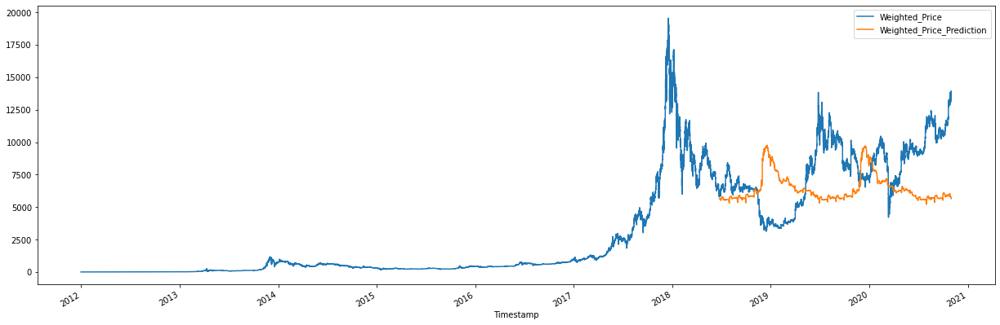

In [ ]:
_ = data_all[['Weighted_Price','Weighted_Price_Prediction']].plot(figsize=(21, 7))

5.2.3 Evaluation metrics (MAE, MSE, RMSE)

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error

mae = mean_absolute_error(y_true=testing_data['Weighted_Price'],
                   y_pred=testing_data['Weighted_Price_Prediction'])

print("Mean Accuracy Error:\n")
print(mae)

Mean Accuracy Error:

2862.3963888597596


In [ ]:
mse = mean_squared_error(y_true=testing_data['Weighted_Price'],
                   y_pred=testing_data['Weighted_Price_Prediction'])

print("Mean Square Error:\n")
print(mse)

Mean Square Error:

11598014.06307204


In [ ]:
import math
rmse = math.sqrt(mse)

print("Root Mean Square Error:\n")
print(rmse)

Root Mean Square Error:

3405.5857151262603


5.2.4 Evaluation metrics (Variance regression score, R2 score)

In [ ]:
from sklearn.metrics import explained_variance_score
evr = (explained_variance_score(y_true=testing_data['Weighted_Price'], y_pred=testing_data['Weighted_Price_Prediction']))*100

print("Explained variance regression score:", evr, "%")

Explained variance regression score: -58.273805070541115 %


In [ ]:
from sklearn.metrics import r2_score
r2 = (r2_score(y_true=testing_data['Weighted_Price'], y_pred=testing_data['Weighted_Price_Prediction']))*100

print("R2 score:", r2, "%")

R2 score: -88.25574488031418 %


### 5.3 Long short term memory (LSTM)

5.3.1 Modelling

In [ ]:
# splitting data into training and test sets
day_of_split = '25-Jun-2018'

testing_data = new_df.loc[new_df.index > day_of_split].copy()
training_data = new_df.loc[new_df.index <= day_of_split].copy()

print(testing_data.shape)
print(training_data.shape)

(20639, 1)
(56826, 1)


In [ ]:
# data preprocessing
set_train_val = training_data.values
set_train_val = np.reshape(set_train_val, (len(set_train_val), 1))

from sklearn.preprocessing import MinMaxScaler

mms = MinMaxScaler()
set_train_val = mms.fit_transform(set_train_val)
y_train = set_train_val[1: len(set_train_val)]
X_train = set_train_val[0: len(set_train_val)-1]

print(X_train.shape)
print(y_train.shape)

(56825, 1)
(56825, 1)


In [ ]:
# import the Keras packages and libraries

from keras.models import Sequential
from keras.layers import Dropout
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers import Activation

lstm_model = Sequential()

# adding layers
lstm_model.add(LSTM(128,activation = "sigmoid", input_shape = (1,1), return_sequences = True))
lstm_model.add(Dropout(0.2))
lstm_model.add(LSTM(units=50, return_sequences = True))
lstm_model.add(Dropout(0.2))
lstm_model.add(LSTM(units=50, return_sequences = True))
lstm_model.add(LSTM(units=50, return_sequences = True))
lstm_model.add(LSTM(units=50, return_sequences = True))
lstm_model.add(Activation('linear'))
lstm_model.add(LSTM(units=50))
lstm_model.add(Dense(1))


lstm_model.compile(loss='mean_squared_error', optimizer='adam', metrics=['accuracy'])
history = lstm_model.fit(X_train, y_train, epochs=100, batch_size=50, verbose=1, validation_split = 0.05)

Epoch 1/100
1080/1080 [==============================] - 37s 24ms/step - loss: 0.0093 - accuracy: 3.7049e-05 - val_loss: 0.0021 - val_accuracy: 0.0000e+00
Epoch 2/100
1080/1080 [==============================] - 14s 13ms/step - loss: 0.0022 - accuracy: 3.7049e-05 - val_loss: 0.0032 - val_accuracy: 0.0000e+00
Epoch 3/100
1080/1080 [==============================] - 17s 16ms/step - loss: 0.0015 - accuracy: 3.7049e-05 - val_loss: 1.1135e-04 - val_accuracy: 0.0000e+00
Epoch 4/100
1080/1080 [==============================] - 14s 13ms/step - loss: 0.0011 - accuracy: 3.7049e-05 - val_loss: 7.2305e-05 - val_accuracy: 0.0000e+00
Epoch 5/100
1080/1080 [==============================] - 14s 13ms/step - loss: 8.0719e-04 - accuracy: 3.7049e-05 - val_loss: 0.0010 - val_accuracy: 0.0000e+00
Epoch 6/100
1080/1080 [==============================] - 14s 13ms/step - loss: 6.4673e-04 - accuracy: 3.7049e-05 - val_loss: 6.2582e-05 - val_accuracy: 0.0000e+00
Epoch 7/100
1080/1080 [===========================

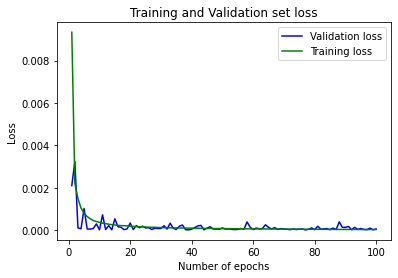

In [ ]:
epoch = range(1,101)

training_loss = history.history['loss']
validation_loss = history.history['val_loss']

plt.plot(epoch, validation_loss, 'b', label='Validation loss')
plt.plot(epoch, training_loss, 'g', label='Training loss')

plt.title('Training and Validation set loss')
plt.ylabel('Loss')
plt.xlabel('Number of epochs')
plt.legend()
plt.show()

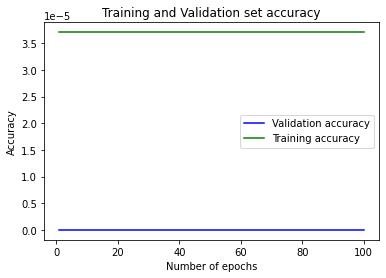

In [ ]:
epoch = range(1,101)

training_loss = history.history['accuracy']
validation_loss = history.history['val_accuracy']

plt.plot(epoch, validation_loss, 'b', label='Validation accuracy')
plt.plot(epoch, training_loss, 'g', label='Training accuracy')


plt.title('Training and Validation set accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Number of epochs')
plt.legend()
plt.show()

4.3.2 Prediction

In [ ]:
# making predictions

set_test_val = testing_data.values

insert = np.reshape(set_test_val, (len(set_test_val), 1))
insert = mms.transform(insert)
insert = np.reshape(insert, (len(insert), 1))

btc_price_prediction = svr_rbf_model.predict(insert)
btc_price_prediction = btc_price_prediction.reshape(1, -1)
btc_price_prediction = mms.inverse_transform(btc_price_prediction)
btc_price_prediction = btc_price_prediction.reshape(-1, 1)

btc_price_prediction

array([[ 6924.83561092],
       [ 6907.48006686],
       [ 6893.83278297],
       ...,
       [13122.97472327],
       [13116.58476223],
       [13138.40079406]])

In [ ]:
testing_data['Weighted_Price_Prediction'] = btc_price_prediction
data_all = pd.concat([testing_data, training_data], sort=False)

#saving the predicted values in a common data frame for future comparision
df_last = pd.merge(df_last, data_all, sort=False)
df_last = df_last.rename(columns = {'Weighted_Price_Prediction': 'LSTM'})
df_last = df_last[['Timestamp','Weighted_Price','SVR','XGBoost', 'LSTM']]
df_last.head()

,Timestamp,Weighted_Price,SVR,XGBoost,LSTM
0,2018-06-25 01:00:00,6169.865248,6924.835611,5631.831543,6924.835611
1,2018-06-25 02:00:00,6148.338059,6907.480067,5631.831543,6907.480067
2,2018-06-25 03:00:00,6131.410461,6893.832783,5631.831543,6893.832783
3,2018-06-25 04:00:00,6139.076296,6900.013094,5631.831543,6900.013094
4,2018-06-25 05:00:00,6141.563349,6902.018194,5632.162109,6902.018194


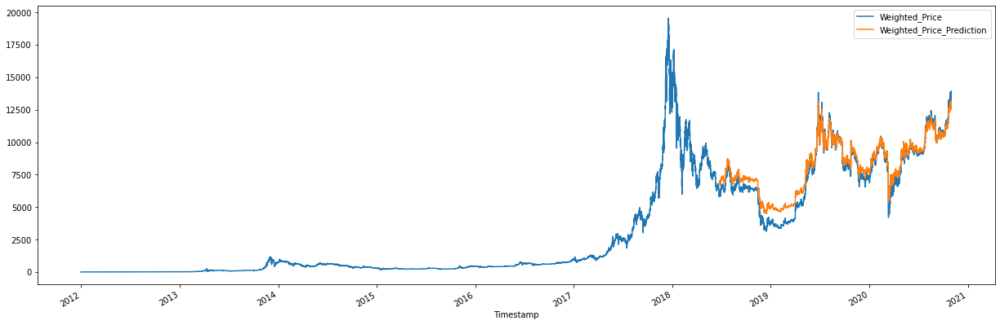

In [ ]:
_ = data_all[['Weighted_Price','Weighted_Price_Prediction']].plot(figsize=(21, 7))

5.3.2 Evaluation metrics (MAE, MSE, RMSE)

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error

mae = mean_absolute_error(y_true=testing_data['Weighted_Price'],
                   y_pred=testing_data['Weighted_Price_Prediction'])

print("Mean Accuracy Error:\n")
print(mae)

Mean Accuracy Error:

524.2505018207187


In [ ]:
mse = mean_squared_error(y_true=testing_data['Weighted_Price'],
                   y_pred=testing_data['Weighted_Price_Prediction'])

print("Mean Square Error:\n")
print(mse)

Mean Square Error:

425452.7992307225


In [ ]:
import math
rmse = math.sqrt(mse)

print("Root Mean Square Error:\n")
print(rmse)

Root Mean Square Error:

652.2674292272476


5.3.3 Evaluation metrics (Variance regression score, R2 score)

In [ ]:
from sklearn.metrics import explained_variance_score
evr = (explained_variance_score(y_true=testing_data['Weighted_Price'], y_pred=testing_data['Weighted_Price_Prediction']))*100

print("Explained variance regression score:", evr, "%")

Explained variance regression score: 96.2448274422399 %


In [ ]:
from sklearn.metrics import r2_score
r2 = (r2_score(y_true=testing_data['Weighted_Price'], y_pred=testing_data['Weighted_Price_Prediction']))*100

print("R2 score:", r2, "%")

R2 score: 93.09416826061518 %
